In [237]:
import tensorflow as tf
from tensorflow.keras import models ,layers, Sequential
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import numpy as np

In [74]:
IMAGE_SIZE = (256,256)

In [75]:
from pathlib import Path
DIRECTORY = Path("C:/Users/yassi/Desktop/DL and ML/Potato-Disease-Classification/training/PlantVillage")


In [76]:
Dataset  = tf.keras.preprocessing.image_dataset_from_directory(
    directory = DIRECTORY ,
    labels='inferred',   
    batch_size= 32 ,
    image_size = IMAGE_SIZE,
    shuffle=True
)

Found 2152 files belonging to 3 classes.


In [77]:
CLASS_names = Dataset.class_names
CLASS_names


['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy']

(32, 256, 256, 3)


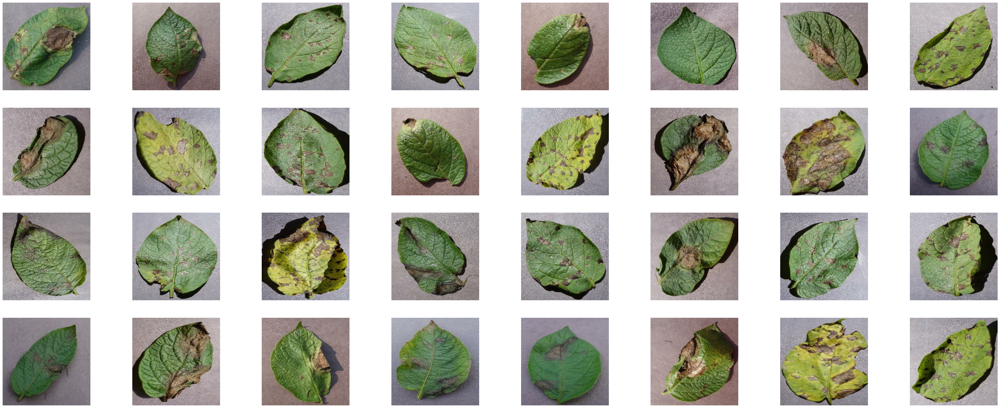

In [238]:
plt.figure(figsize=(50,20))

for image_batch , label_batch in Dataset.take(1):
    print(image_batch.shape)
    for i in range(32):
        plt.subplot(4,8,i+1)    
        plt.imshow(image_batch[i].numpy().astype('uint8'))
        plt.axis("off")


        
        

# ==> the Dataset.take(1) takes the first batch of the Dataset 
remark : when plotting using the plt.imshow we need to convert to numpy() and with uint8 type using astype("uint8")

# Splitting the DATASET


In [80]:
# shuffling the data
Dataset_shuffled = Dataset.shuffle(buffer_size=100 ,seed=15)

In [81]:
train_size = int(0.8 * len(Dataset_shuffled))
test_size = len(Dataset_shuffled) - train_size


In [82]:
train_size

54

In [83]:
train_dataset = Dataset_shuffled.take(train_size)
test_dataset  = Dataset_shuffled.skip(train_size)

In [84]:
validation_ds = test_dataset.take(int(0.1 * len(Dataset_shuffled)))

In [167]:
len(validation_ds)

6

In [86]:
test_dataset = test_dataset.skip(6)

# caching and prefetching for acceleration purpose

In [87]:
train_dataset = train_dataset.cache().shuffle(1000).prefetch(buffer_size = tf.data.AUTOTUNE)
test_dataset = test_dataset.cache().shuffle(400).prefetch(buffer_size = tf.data.AUTOTUNE)
validation_ds = validation_ds.cache().shuffle(100).prefetch(buffer_size = tf.data.AUTOTUNE)

# preprocessing and rescaling and Data Augmantation

In [91]:
class DataPreprocessed : 
    def __init__(self):
        pass 
    def resize_rescale(self , image_size):
        resize_rescale_layer = Sequential([
            layers.experimental.preprocessing.Resizing(image_size,image_size),
            layers.experimental.preprocessing.Rescaling(1.0/255)

            
        ])
        return resize_rescale_layer
    def data_augmentation(self):
            data_augmentation_layer = Sequential([
                layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
                layers.experimental.preprocessing.RandomRotation(0.2),
            ])
            return data_augmentation_layer


# Model Building

In [92]:
datapreprocessed = DataPreprocessed()

In [168]:
image_size = 256
n_channels = 3
batch_size = 32 
input_shape = (batch_size , image_size,image_size,n_channels) 

n_classses = len(Dataset.class_names) 

In [169]:
n_classses

3

In [214]:
type(input_shape)

tuple

In [216]:
def build_model( input_shape:tuple ) -> Sequential:
 
  model = Sequential()
  
  model.add(datapreprocessed.resize_rescale(image_size))  
  model.add(datapreprocessed.data_augmentation())
  
  
  # trying the keras tuner on the first conv layer 
  
  model.add(layers.Conv2D(32 , (3 , 3), activation = 'relu', input_shape = input_shape ))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Conv2D(64,  kernel_size = (3,3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Conv2D(64,  kernel_size = (3,3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  
  model.add(layers.Flatten())
  model.add(layers.Dense(64, activation='relu'))
  model.add(layers.Dense(n_classses, activation='softmax'))
  
  model.compile (
    optimizer=Adam( learning_rate= 0.001) ,
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
    ) 
    
    
  return model

In [204]:
Mymodel = build_model(input_shape)

In [215]:
type(Mymodel)

keras.src.engine.sequential.Sequential

In [205]:
Mymodel.build(input_shape =input_shape )

In [217]:
Mymodel.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_7 (Sequential)   (None, 256, 256, 3)       0         
                                                                 
 sequential_8 (Sequential)   (None, 256, 256, 3)       0         
                                                                 
 conv2d_14 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 127, 127, 32)      0         
 ng2D)                                                           
                                                                 
 conv2d_15 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_13 (MaxPooli  (None, 62, 62, 64)        0         
 ng2D)                                                

 # Model Compiling

In [208]:

Mymodel.compile(
    optimizer=  model_optimizer ,
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy' ]
)

In [209]:
N_EPOCHS = 40 

In [210]:
history = Mymodel.fit(
    train_dataset , 
    epochs = N_EPOCHS , 
    batch_size = batch_size,
    verbose = 1,
    validation_data = validation_ds 
)

Epoch 1/40
54/54 [==============================] - 33s 574ms/step - loss: 0.9168 - accuracy: 0.4830 - val_loss: 0.9947 - val_accuracy: 0.4635
Epoch 2/40
54/54 [==============================] - 31s 570ms/step - loss: 0.7934 - accuracy: 0.6397 - val_loss: 0.6584 - val_accuracy: 0.7135
Epoch 3/40
54/54 [==============================] - 34s 633ms/step - loss: 0.5916 - accuracy: 0.7500 - val_loss: 0.8760 - val_accuracy: 0.6198
Epoch 4/40
54/54 [==============================] - 33s 613ms/step - loss: 0.5258 - accuracy: 0.7893 - val_loss: 0.8050 - val_accuracy: 0.6615
Epoch 5/40
54/54 [==============================] - 30s 558ms/step - loss: 0.4017 - accuracy: 0.8275 - val_loss: 0.4909 - val_accuracy: 0.7760
Epoch 6/40
54/54 [==============================] - 29s 532ms/step - loss: 0.3530 - accuracy: 0.8474 - val_loss: 0.6724 - val_accuracy: 0.7031
Epoch 7/40
54/54 [==============================] - 29s 529ms/step - loss: 0.3205 - accuracy: 0.8627 - val_loss: 0.5509 - val_accuracy: 0.7865

# Displaying the accuracy curve

In [211]:
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']


Text(0.5, 1.0, 'Training vs validation Loss')

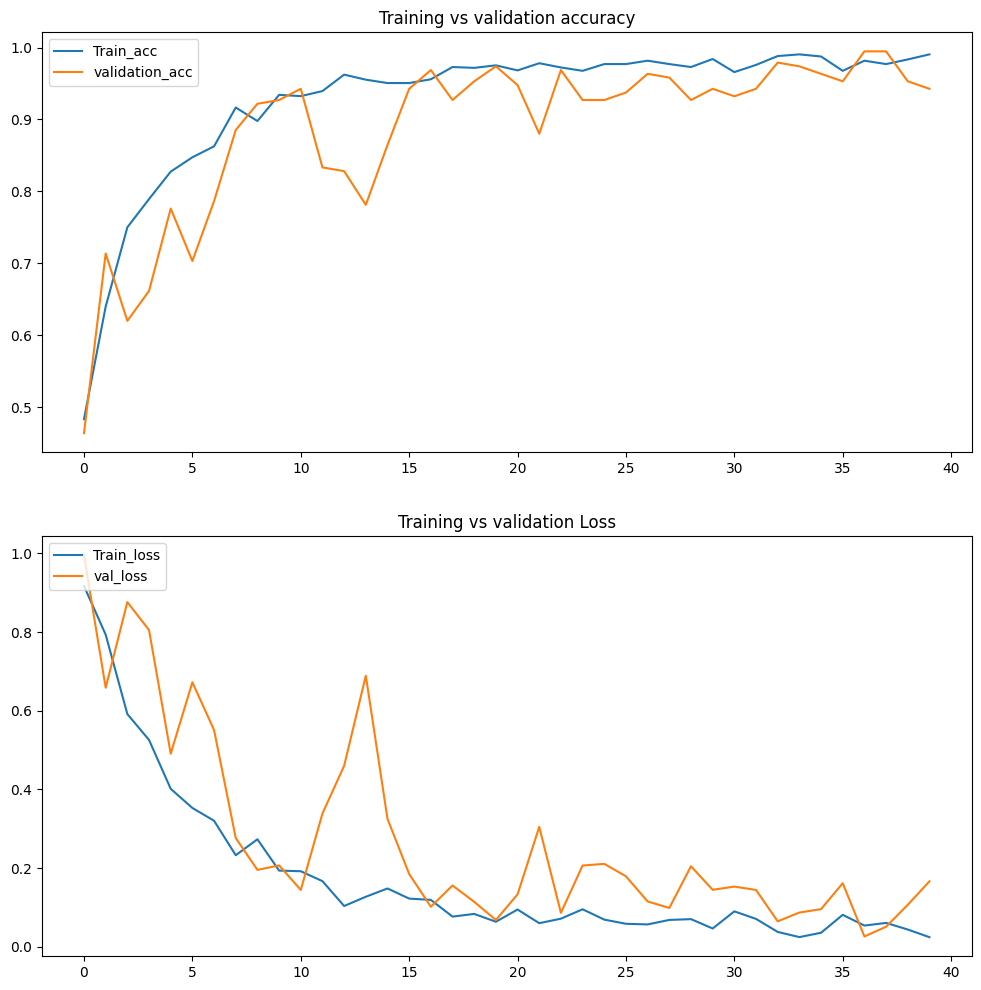

In [212]:
plt.figure(figsize=(12,12))
plt.subplot(2,1,1)
plt.plot(range(N_EPOCHS) , accuracy , label = "Train_acc")
plt.plot(range(N_EPOCHS) , val_accuracy , label = "validation_acc")
plt.legend(loc = 'upper left')
plt.title("Training vs validation accuracy")
plt.subplot(2,1,2)
plt.plot(range(N_EPOCHS) , loss , label = "Train_loss")
plt.plot(range(N_EPOCHS) , val_loss , label = "val_loss")
plt.legend(loc = 'upper left')
plt.title("Training vs validation Loss")

(32, 256, 256, 3)


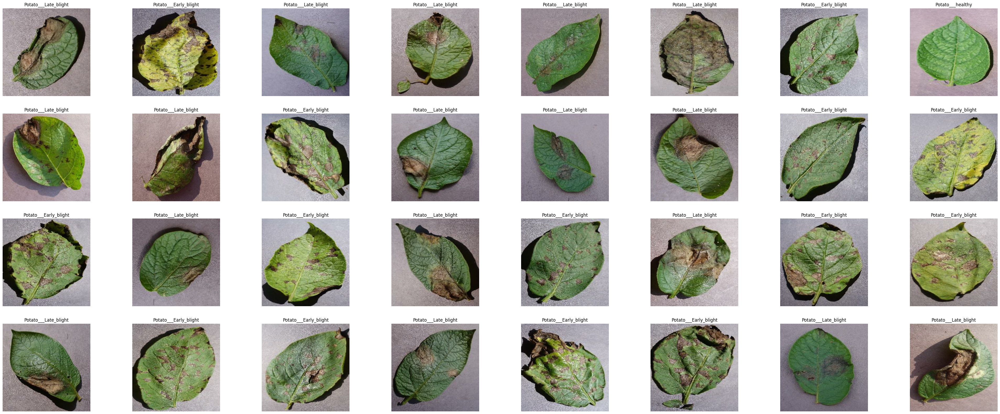

In [213]:
plt.figure(figsize=(50,20))

for image_batch , label_batch in test_dataset.take(1):
    print(image_batch.shape)
    for i in range(32):
        plt.subplot(4,8,i+1)    
        plt.imshow(image_batch[i].numpy().astype('uint8'))
        plt.axis("off")
        plt.title(CLASS_names[label_batch[i]])


In [180]:
!pip install keras-tuner 


     ------------------------------------ 129.1/129.1 kB 223.9 kB/s eta 0:00:00


In [218]:
Mymodel.predict(test_dataset.take(1))

1/1 [==============================] - 0s 395ms/step


array([[1.9622344e-04, 9.9980384e-01, 5.1479030e-09],
       [1.0000000e+00, 3.8711569e-12, 3.3999817e-23],
       [3.0938461e-03, 9.9690598e-01, 2.1493270e-07],
       [1.8911040e-05, 9.9998105e-01, 2.8221375e-08],
       [2.5871152e-05, 9.9951160e-01, 4.6252570e-04],
       [7.9462332e-01, 2.0536999e-01, 6.7175392e-06],
       [9.9999201e-01, 7.9594911e-06, 5.3464793e-09],
       [3.9723577e-06, 9.1390535e-03, 9.9085695e-01],
       [2.4926501e-07, 9.9999893e-01, 8.7011330e-07],
       [3.2651919e-08, 9.9999964e-01, 2.9280002e-07],
       [1.0000000e+00, 7.3760185e-11, 5.7682406e-19],
       [1.7561816e-06, 9.9969137e-01, 3.0687446e-04],
       [4.0417811e-07, 9.9999964e-01, 1.2033020e-08],
       [6.6495166e-05, 9.9993348e-01, 2.0832518e-09],
       [9.9999905e-01, 9.6946053e-07, 4.9761254e-11],
       [1.0000000e+00, 2.7225423e-11, 5.9515445e-20],
       [1.0000000e+00, 8.5375353e-11, 7.3330580e-17],
       [7.9297285e-10, 9.9987650e-01, 1.2344895e-04],
       [1.0000000e+00, 1.504

In [219]:
iterator = test_dataset.as_numpy_iterator()


In [222]:
image_batch , label_batch =next(iterator)

In [234]:
def predict(model :Sequential , img):
    img_array = tf.keras.preprocessing.image.img_to_array(img.numpy())
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)

    predicted_class = CLASS_names[np.argmax(predictions[0])]
    
    return predicted_class 

1/1 [==============================] - 0s 51ms/step


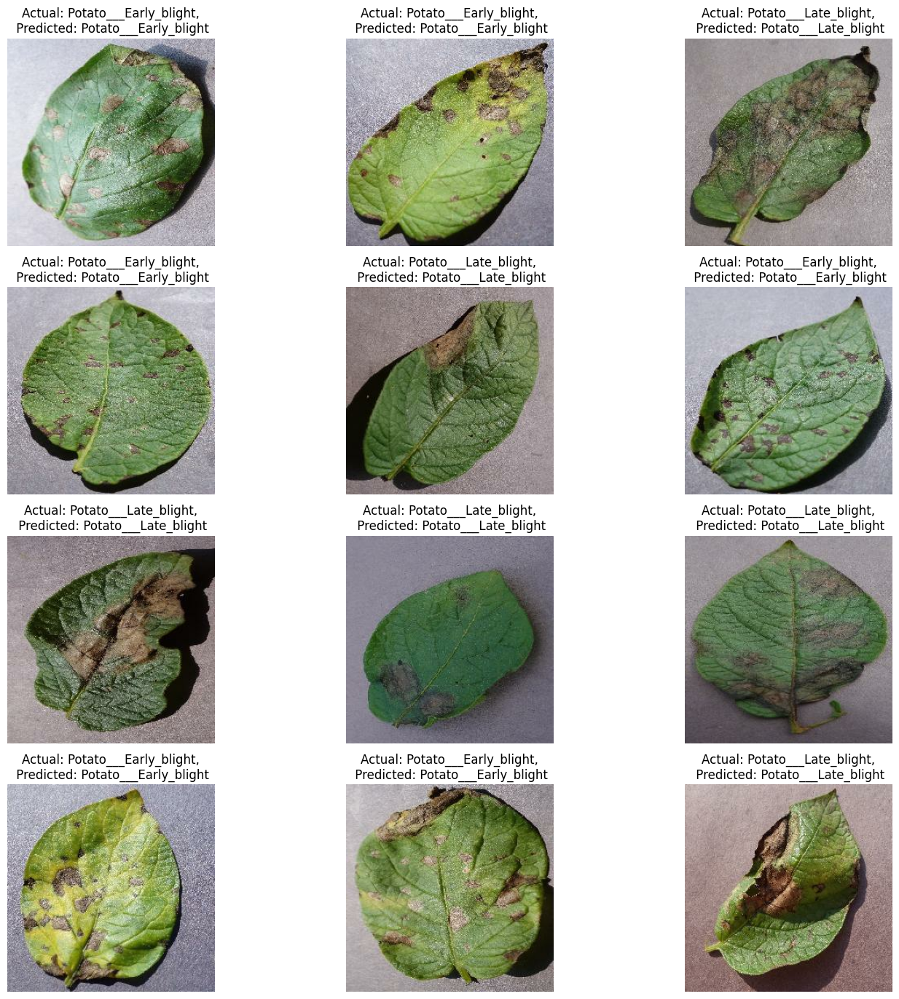

In [235]:
plt.figure(figsize=(17, 17))
for images, labels in test_dataset.take(1):
    for i in range(12):
        ax = plt.subplot(4, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        
        predicted_class = predict(Mymodel, images[i])
        actual_class = CLASS_names[labels[i]] 
        
        plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}")
        
        plt.axis("off")

In [236]:
model_version = 0
Mymodel.save(f"../models/{model_version}")

INFO:tensorflow:Assets written to: ../models/0\assets


INFO:tensorflow:Assets written to: ../models/0\assets
